In [ ]:
! wget https://paddleocr.bj.bcebos.com/whl/layoutparser-0.0.0-py3-none-any.whl
!pip install -U layoutparser-0.0.0-py3-none-any.whl

--2023-11-20 14:19:39--  https://paddleocr.bj.bcebos.com/whl/layoutparser-0.0.0-py3-none-any.whl
Resolving paddleocr.bj.bcebos.com (paddleocr.bj.bcebos.com)... 103.235.46.61, 2409:8c04:1001:1002:0:ff:b001:368a
Connecting to paddleocr.bj.bcebos.com (paddleocr.bj.bcebos.com)|103.235.46.61|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 19145360 (18M) [application/octet-stream]
Saving to: ‘layoutparser-0.0.0-py3-none-any.whl’

layoutparser-0.0.0- 100%[===================>]  18.26M  4.85MB/s    in 19s     

2023-11-20 14:20:00 (959 KB/s) - ‘layoutparser-0.0.0-py3-none-any.whl’ saved [19145360/19145360]

Processing ./layoutparser-0.0.0-py3-none-any.whl
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 1.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for iopath: filename=iopath-0.1.10-py3-none-any.whl size=31532 sha256=2b76ce4aa7eef58b2a2ad46cdacaae5e1de7660e8a6a657569ea97fdce3f5945
  Stored in directory: /root/.cache/pip/wheels

In [ ]:
!pip install paddlepaddle

In [ ]:
!pip install "paddleocr>=2.0.1"

In [ ]:
!sudo apt install tesseract-ocr

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2.1build1).
0 upgraded, 0 newly installed, 0 to remove and 9 not upgraded.


In [ ]:
!pip install opencv-python

In [ ]:
import numpy as np
import layoutparser as lp
import cv2
from google.colab.patches import cv2_imshow

In [ ]:
image = cv2.imread("/content/PM News December 1_1994_Pg 1.jpg")

In [ ]:
image.shape

(2863, 2192, 3)

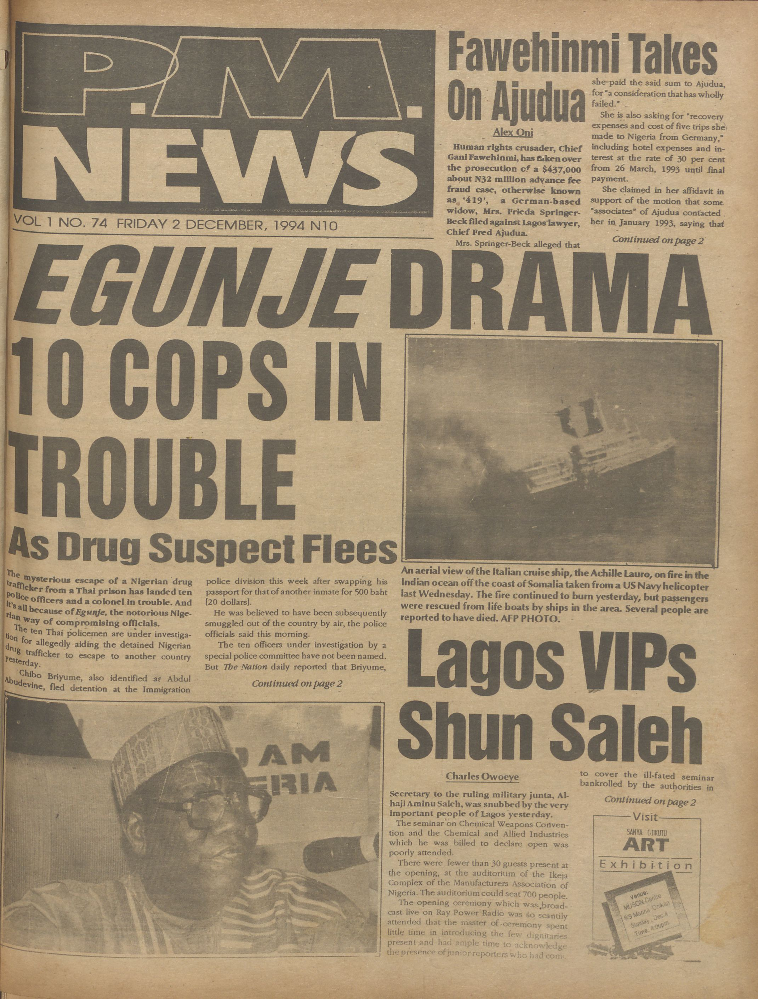

In [ ]:
cv2_imshow(image)

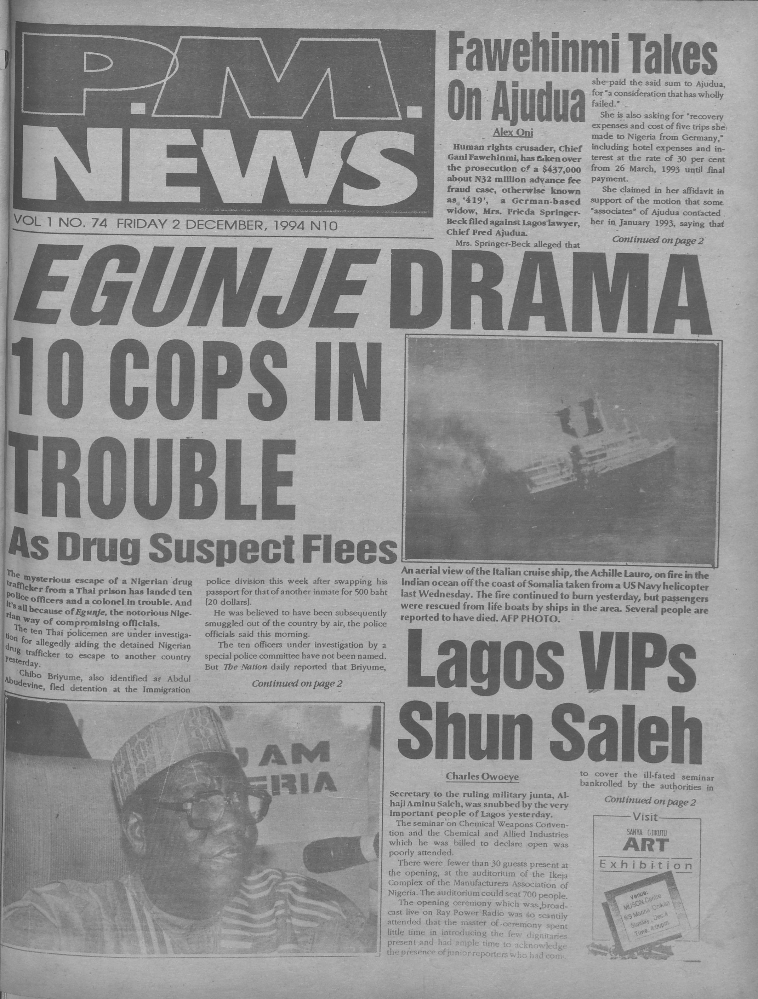

In [ ]:
# Use the cvtColor() function to grayscale the image
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

cv2_imshow(gray_image)

In [ ]:
gray_image.shape

(2824, 2141)

In [ ]:
# Expand the single-channel grayscale to three channels
gray_image_three_channels = np.expand_dims(gray_image, axis=2)
gray_image_three_channels = np.repeat(gray_image_three_channels, 3, axis=2)

In [ ]:
gray_image_three_channels.shape

(2824, 2141, 3)

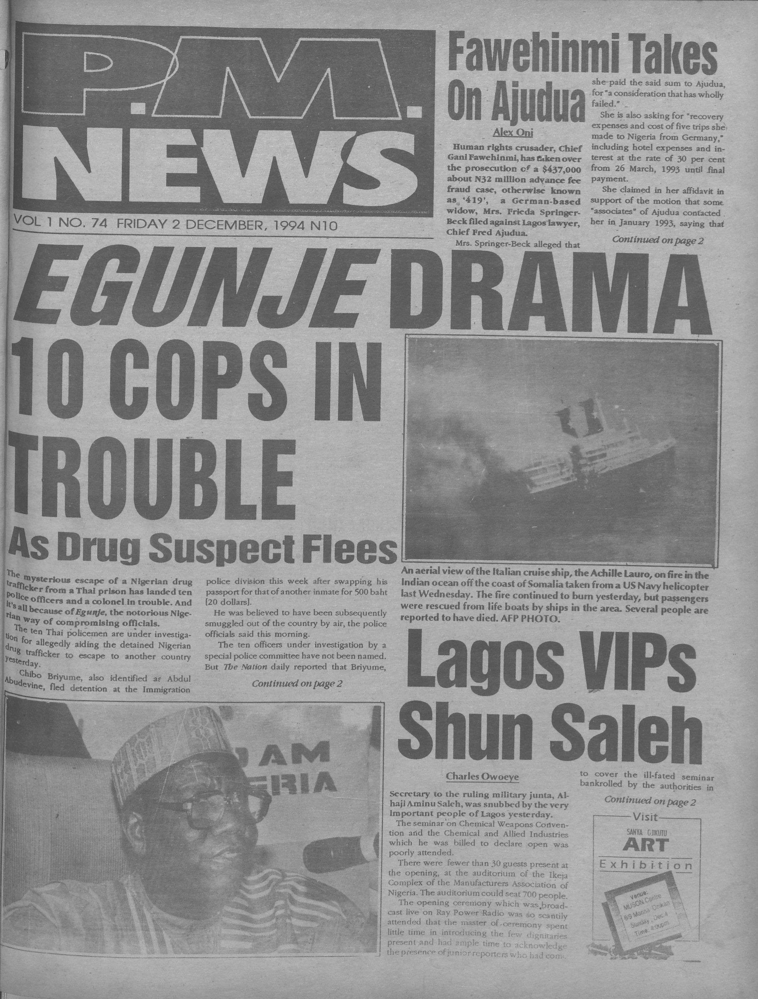

In [ ]:
cv2_imshow(gray_image_three_channels)

In [ ]:
image = gray_image_three_channels[..., ::-1]

In [ ]:
# load model
model = lp.models.PaddleDetectionLayoutModel(config_path="lp://PubLayNet/ppyolov2_r50vd_dcn_365e_publaynet/config",
                                threshold=0.7,
                                label_map={0: "Text", 1: "Title", 2: "List", 3:"Table", 4:"Figure"},
                                enforce_cpu=False,
                                enable_mkldnn=True
                                             )

In [ ]:
layout = model.detect(image)
    # Detect the layout of the input image

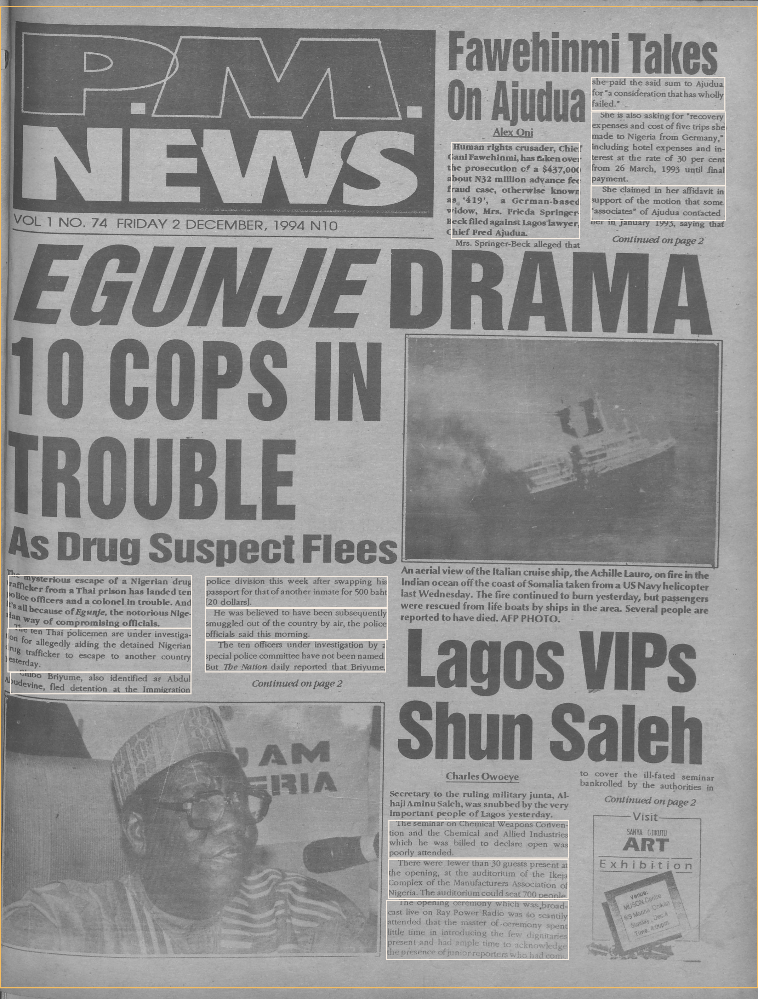

In [ ]:
lp.draw_box(image, layout, box_width=3)
    # Show the detected layout of the input image

In [ ]:
type(layout)

layoutparser.elements.Layout

In [ ]:
layout[0]

TextBlock(block=Rectangle(x_1=1669.9031982421875, y_1=217.87051391601562, x_2=2048.95166015625, y_2=312.8434753417969), text=None, id=None, type=Text, parent=None, next=None, score=0.9506247043609619)

In [ ]:
text_blocks = lp.Layout([b for b in layout if b.type=='Text'])
figure_blocks = lp.Layout([b for b in layout if b.type=='Figure'])

In [ ]:
# for txt in text_blocks.get_texts():
#     print(txt, end='\n---\n')

In [ ]:

# text_blocks = lp.Layout([b for b in text_blocks \
#                    if not any(b.is_in(b_fig) for b_fig in figure_blocks)])

In [ ]:
ocr_agent = lp.TesseractAgent(languages='eng')
    # Initialize the tesseract ocr engine. You might need
    # to install the OCR components in layoutparser:
    # pip install layoutparser[ocr]

In [ ]:
for block in text_blocks:
    segment_image = (block
                       .pad(left=5, right=5, top=5, bottom=5)
                       .crop_image(image))
        # add padding in each image segment can help
        # improve robustness

    text = ocr_agent.detect(segment_image)
    block.set(text=text, inplace=True)

In [ ]:
for txt in text_blocks.get_texts():
    print(txt, end="\n")

she-paid the said sum to Ajudua,
for“a consideration thathas wholly
failed. .

She is also asking for “recovery
expenses and cost of five trips she:
made to Nigeria from Germany,”
including hotel expenses and in-
terest at the rate of 30 per cent
from 26 March, 1993 until final
payment.

He was believed to have been subsequently
smuggled out of the country by air, the police
officials said this morning.

The ten officers under investigation by a
special police committee have not been named.
But The Nation daily reported that Briyume,

police division this week after swapping his
passport for that of another inmate for $00 baht
{20 dollars].

oe Mysterious escape of a Nigerian drug

Ba ker from a Thai prison has landed ten
nee Officers and a colonel in trouble. And
fake because of Egunje, the notorious Nige-

aay of compromising officials.

She claimed in her affidavit in
support of the motion that some
“associates” of Ajudua contacted .

ee aoe ae ee Ne ee

_ 7 ten Thai policeme

In [ ]:
for txt in text_blocks.get_texts():
    print(txt, end='\n---\n')

she-paid the said sum to Ajudua,
for“a consideration thathas wholly
failed. .

---
She is also asking for “recovery
expenses and cost of five trips she:
made to Nigeria from Germany,”
including hotel expenses and in-
terest at the rate of 30 per cent
from 26 March, 1993 until final
payment.

---
He was believed to have been subsequently
smuggled out of the country by air, the police
officials said this morning.

---
The ten officers under investigation by a
special police committee have not been named.
But The Nation daily reported that Briyume,

---
police division this week after swapping his
passport for that of another inmate for $00 baht
{20 dollars].

---
oe Mysterious escape of a Nigerian drug

Ba ker from a Thai prison has landed ten
nee Officers and a colonel in trouble. And
fake because of Egunje, the notorious Nige-

aay of compromising officials.

---
She claimed in her affidavit in
support of the motion that some
“associates” of Ajudua contacted .

ee aoe ae ee Ne ee

In [ ]:
!pip install pytesseract

In [ ]:
import pytesseract

In [ ]:
image = cv2.imread("/content/PM News December 1_1994_Pg 1.jpg")

In [ ]:
img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
print(pytesseract.image_to_string(img_rgb))

 
 
  

 
 
   
 

 

SRA

we Hees
20 More

States ea

Why! Annulled
June 12-IBB

Former dictator, General Ibrahim Babangida
broke his silence on the country’s political crisis
for the first time, saying he annulled the June 12
1993 Presidential Election bechuse of electoral
irregularities. ©
Speaking in an interview with BBC [British Corporation
Corporation] this morning at his Minna palatial resi-
dence, General Babaigida said there were "some
irregularities” in the conduct of the election.
Reminded that international observers whs monitored
the election adjudged it the fairest and freest in the
nation’s political history, General Babangida said:
“Yes, it is true that there were some international
observers but they cannot cover all the over 70,000
polling booths located throughout the country effec-
tively to know all the irregularities involved”.

ALEX KABBA

A committee of the Con-
stitutional Conference has
|, recommended that 20
more states be created.
The committee which is
exp